In [54]:
import numpy as np
import random
import pandas as pd
import matplotlib.pyplot as plt

def normalize (arr):
    return arr/np.sum(arr)

In [111]:
variables = ['A', 'B', 'C', 'D']
ne_variables = ['A', 'C', 'D']
num_samples = 40000
obs = {'B' : 1}



# define factors, I am sure this can be done better by defining a factor object.

f_a_b = {'A' : {0 : [30, 5]  , 1 : [1, 10]}  , 'B' : {0 : [30, 1], 1 : [5,10]}}
f_b_c = {'B' : {0 : [100, 1] , 1 : [1, 100]} , 'C' : {0 : [100, 1], 1 : [1,100]}}
f_c_d = {'C' : {0 : [1, 100] , 1 : [100, 1]} , 'D' : {0 : [1, 100], 1 : [100,1]}}
f_a_d = {'A' : {0 : [100, 1] , 1 : [1, 100]} , 'D' : {0 : [100, 1], 1 : [1,100]}}


# easier to have this than getting the markov blanket
factors_invloving = {'A' : [f_a_b, f_a_d] , 'B' : [f_a_b, f_b_c] , 'C' : [f_b_c, f_c_d] , 'D' : [f_c_d, f_a_d]}

In [112]:
# random intitialization of non evidence variables
assignment = {v:random.getrandbits(1) for v in ne_variables}
# add obeservation 
assignment.update(obs)
print("assignment random")
print(assignment)
samples = pd.DataFrame()
p_A = []

for s in range(num_samples):
    
    # choose the next variable to sample
    to_sample = random.choice(ne_variables) 
    print ("sampling " + to_sample)
    # get a list of variables to iterate over 
    remaining_var = [val for val in variables if val != to_sample]
    print ("variables to iterate over for factors")
    print(remaining_var)
    #declare array to save probability distribution to sample from
    probability_dist = np.array([1,1])
    print ("factors involved in this var")
    print(factors_invloving[to_sample])
    for v in remaining_var:

        for f in factors_invloving[to_sample]:
            if v not in f.keys():
                continue
            print("setting " + v + " as per its assignment")
            print ("Table for " + v)
            print (f[v][assignment[v]])
            probability_dist *= f[v][assignment[v]]
            probability_dist = normalize(probability_dist)
    print("Probability dist to sample from")
    print (probability_dist)

    if random.uniform(0, 1) <= probability_dist[0]:
        assignment[to_sample] = 0
    else: 
        assignment[to_sample] = 1   
    print("sample generated")
    print(assignment)
    samples = samples.append(assignment, ignore_index=True)
    p_A.append(sum(samples.A)/(s+1))
    

assignment random
{'A': 1, 'C': 0, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C

variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
s

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[

setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784

Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample f

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involve

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
fact

[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involve

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {

[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.019607

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.99900

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: 

[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.99900

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involve

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1,

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C'

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Pro

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
fact

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involve

[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involve

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.99

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]},

[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]},

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-

variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C':

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
s

[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 

Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sam

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100,

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B':

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for fac

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
samplin

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.99900

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
fact

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [

Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this v

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
fact

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C'

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]


sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1],

[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
fact

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.99900

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling 

Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 

Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]},

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05

[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1,

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1,

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D':

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over fo

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over fo

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
fact

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.99900

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample f

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D':

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0:

setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
P

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
v

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
s

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.999000

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 

[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over fo

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 1

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.99900

Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
P

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {

sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D'

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0

['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05

variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D':

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate o

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sam

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B':

[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B

[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 1

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate o

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over fo

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{

['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A

setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors 

[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate o

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B':

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables t

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1:

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
v

['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: 

[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B',

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
fact

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.

Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B':

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D'

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0,

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involve

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]},

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generate

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]},

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100,

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iter

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D':

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0,

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 1

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {

Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0,

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables t

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D':

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D':

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0,

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D':

[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.99900

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D'

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A

[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1,

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0,

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iter

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
[

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.019607

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1,

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D'

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]},

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 

setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
samp

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D'

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
samp

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C'

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D':

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 1

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate o

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C':

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[0.00497512 0.99502488]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D'

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D':

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 1, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 10

Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample f

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.5 0.5]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[1, 100]
setting C as per its assignment
Table for C
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 1, 'C': 0, 'D': 1, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {

sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1]

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling C
variables to iterate over for factors
['A', 'B', 'D']
factors involved in this var
[{'B': {0: [100, 1], 1: [1, 100]}, 'C': {0: [100, 1], 1: [1, 100]}}, {'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}]
setting B as per its assignment
Table for B
[1, 100]
setting D as per its assignment
Table for D
[1, 100]
Probability dist to sample from
[9.9990001e-05 9.9990001e-01]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5],

sampling A
variables to iterate over for factors
['B', 'C', 'D']
factors involved in this var
[{'A': {0: [30, 5], 1: [1, 10]}, 'B': {0: [30, 1], 1: [5, 10]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting B as per its assignment
Table for B
[5, 10]
setting D as per its assignment
Table for D
[100, 1]
Probability dist to sample from
[0.98039216 0.01960784]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100], 1: [100, 1]}, 'D': {0: [1, 100], 1: [100, 1]}}, {'A': {0: [100, 1], 1: [1, 100]}, 'D': {0: [100, 1], 1: [1, 100]}}]
setting A as per its assignment
Table for A
[100, 1]
setting C as per its assignment
Table for C
[100, 1]
Probability dist to sample from
[9.9990001e-01 9.9990001e-05]
sample generated
{'A': 0, 'C': 1, 'D': 0, 'B': 1}
sampling D
variables to iterate over for factors
['A', 'B', 'C']
factors involved in this var
[{'C': {0: [1, 100]

In [113]:
# results of my handy work with VE
f_A = [5001500, 300010]
p_A_0_VE = f_A[0] /sum(f_A)
p_A_1_VE = f_A[1] /sum(f_A)
print("[" + str( p_A_0_VE) + "," + str(p_A_1_VE) + "]")

[0.9434104623022498,0.05658953769775026]


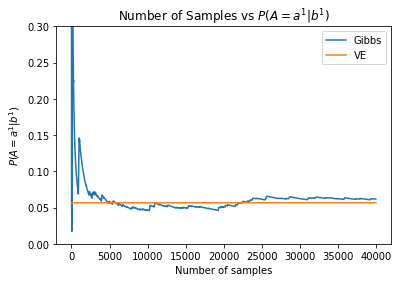

In [124]:
# Plot the handy work and Gibbs sampling together
plt.plot(range(num_samples),p_A, label = "Gibbs")
plt.plot(range(num_samples), np.full(num_samples, p_A_1_VE), label = "VE")
plt.ylim(0, 0.3)
plt.legend()
plt.xlabel("Number of samples")
plt.ylabel("$P(A = a^1 | b^1)$")
plt.title ("Number of Samples vs $P(A = a^1 | b^1)$")
plt.savefig("Q1b_1")

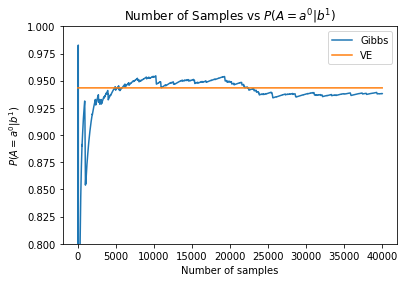

In [125]:
# Plot the P(A=a0 | b1)
plt.plot(range(num_samples),(1-np.array(p_A)), label = "Gibbs")
plt.plot(range(num_samples), np.full(num_samples, p_A_0_VE), label =  "VE")
plt.ylim(0.8, 1)
plt.legend()
plt.xlabel("Number of samples")
plt.ylabel("$P(A = a^0 | b^1)$")
plt.title ("Number of Samples vs $P(A = a^0 | b^1)$")
plt.savefig("Q1b_2")